# PRELIMINARIES 

### STEP 1: run each of these in a separate terminal
#### TERMINAL 1:
export SERVER='carta-cav'

ssh -L 8081:localhost:8081 "$SERVER"

#### TERMINAL 2:
export SERVER='carta-cav'

ssh -L 26025:localhost:26025 "$SERVER"

### STEP 2: update the following two lines at the top of
#### multimodal_class.py

to be the appropriate paths on your system

path_to_VRPsolver = '/Users/dan/Documents/transit_webapp/'

path_to_multimodalsim = '/Users/dan/Documents/multimodal/'


### IMPORTS

In [1]:
%load_ext autoreload
%autoreload 2
from multimodal_class import *

localhost 26025
CARTA_DB_NAME = carta-cav-dev


[db.py:768 - get_mongo_connection_internal_singleton_instance()]DEBUG2024-03-22 04:13:22,045: called


In [2]:
# max_num_people = 300; regions_name = 'C';
# ondemand_cost = 0; num_iters = 6;
# # num_drivers_per_group = {'group0':int(12),'group1':int(4)}; drivers_per_group = '12n4';
# # num_drivers_per_group = {'group0':int(4),'group1':int(12)}; drivers_per_group = '4n12';
# num_drivers_per_group = {'group0':int(8),'group1':int(8)}; drivers_per_group = '8n8';


In [3]:
# csv_file_path = 'INPUTS/PRE_micro_0.csv'
# df = pd.read_csv(csv_file_path);
# print(df.head(2))
# # print(df.columns)

In [ ]:
# num_drivers_per_group = {'group0':int(12),'group1':int(4)}; drivers_per_group = '12n4';
# num_drivers_per_group = {'group0':int(4),'group1':int(12)}; drivers_per_group = '4n12';
# geojson_pickup_file = 'INPUTS/regions' + str(regions_num) + '.geojson'=
# geojson_dropoff_file = 'INPUTS/regions' + str(regions_num) + '.geojson';



### CONSTRUCTING FILE NAMES

In [4]:
max_num_people = 300; regions_name = 'C';
ondemand_cost = 0; num_iters = 6;
num_drivers_per_group = {'group0':int(8),'group1':int(8)}; drivers_per_group = '8n8';

name = 'regions' + regions_name; 
name = name + '_drivers' + drivers_per_group;
name = name + '_cost' + str(ondemand_cost);
name = name + '_people' + str(max_num_people);
name = name + '_iters' + str(num_iters);

geojson_file = 'INPUTS/newregions8.geojson'; # + str(regions_num) + '.geojson';
save_fits_file = 'INPUTS/' + name + '.pickle';
load_fits_file = save_fits_file;
save_outputs_folder = 'OUTPUTS/' + name
dashboard_folder = 'DASH/' + name;

csv_file_path = 'INPUTS/new_pop_data8.csv'

print('geojson_file: ',geojson_file)
print('load_fits_file: ',load_fits_file)
print('save_fits_file: ',save_fits_file)
print('save_outputs_folder: ',save_outputs_folder)
print('dashboard_folder: ',dashboard_folder)

geojson_file:  INPUTS/newregions8.geojson
load_fits_file:  INPUTS/regionsC_drivers8n8_cost0_people300_iters6.pickle
save_fits_file:  INPUTS/regionsC_drivers8n8_cost0_people300_iters6.pickle
save_outputs_folder:  OUTPUTS/regionsC_drivers8n8_cost0_people300_iters6
dashboard_folder:  DASH/regionsC_drivers8n8_cost0_people300_iters6


In [5]:
#'group0':{'direct':'west','pickup':'east','dropoff':'south'}
region_assignment = {
    'group0':{'direct':'south'},
    'group1':{'pickup':'south','dropoff':'downtown2'},
    # 'group2':{'pickup':'west','dropoff':'east'},
    # 'group3':{'pickup':'west','dropoff':'downtown'},
    # 'group4':{'pickup':'east','dropoff':'downtown'}
}

### INITIAL PARAMETER INPUTS

In [6]:
params = {'csv_file_path': csv_file_path, #'INPUTS/PRE_micro_0.csv', 
          'modes':['drive','walk','gtfs','ondemand'],
          'time_window': [21600,36000], # in seconds. 6 AM to 10 AM
          'bnds':[np.array([-85.3394,  34.9458]), # bottom left
                  np.array([-85.2494,  35.0658])], # top right
          'groups_regions_geojson': geojson_file, #'INPUTS/regions3.geojson', 
          'max_num_people':max_num_people, 
          # 'groups_regions_pickup_geojson': geojson_pickup_file, #'INPUTS/regions3.geojson', 
          # 'groups_regions_dropoff_geojson': geojson_dropoff_file, #'INPUTS/regions3.geojson', 
          'num_drivers_per_group': num_drivers_per_group, #{'group0':int(10),'group1':int(4),'group2':int(4)},
          'region_assignment': region_assignment,
          'monetary_costs':{'ondemand':0,'gtfs':1.5},
          # 'background_congestion_file': 'INPUTS/background_traffic1.obj',  # OPTIONAL - LOADS BACKGROUND TRAFFIC
          ############ PRECOMPUTED GTFS DATA ###########
          'load_ondemand_fits': load_fits_file, #'INPUTS/load_file.pickle', 
          'save_ondemand_fits': save_fits_file, #'INPUTS/save_file.pickle',
          'gtfs_feed_file': 'INPUTS/carta_gtfs.zip', 
          'gtfs_precomputed_file': 'INPUTS/gtfs_trips.obj'}

In [7]:
if not os.path.exists(save_outputs_folder):
    os.mkdir(save_outputs_folder);
    os.mkdir(save_outputs_folder+'/figs');

In [8]:
if False: #not os.path.exists(csv_file_path):
    df = GENERATE_SAMPLE_POPULATION('data/pop/lodes_combinations_upd.parquet',filter_region_path=geojson_file,sample_num = 10000)
    df.to_csv(csv_file_path); #, index_label='tag')'INPUTS/new_pop_data1.csv'

In [9]:
# OPTION-1: FULL ONE-SHOT SETUP 
# BLAH = WORLD(params,full_setup = True)
# OPTION-2: STEP-BY-STEP SETUP
WORLD1 = WORLD(params)
WORLD1.initGRAPHSnFEEDS();
WORLD1.initNETWORKS();
WORLD1.initCONVERTER();
WORLD1.initSTATS()
WORLD1.initONDEMAND();
WORLD1.initPEOPLE();
WORLD1.initBACKGROUND();

monetary cost of drive segment: 0 $
monetary cost of walk segment: 0 $
monetary cost of gtfs segment: 1.5 $
monetary cost of ondemand segment: 0 $
loading graph/feed for drive mode...
loading graph/feed for walk mode...
loading graph/feed for gtfs mode...
connecting close bus stops...
Original num of edges:  2113
Final num of edges:  3849
loading graph/feed for ondemand mode...
cutting graphs to boundaries...
composing graphs...
computing reverse graphs...
...reversing drive graph...
...reversing walk graph...
...reversing gtfs graph...
...reversing ondemand graph...
...reversing all graph...
constructing NETWORK  drive mode...
constructing NETWORK  walk mode...
constructing NETWORK  gtfs mode...
constructing NETWORK  ondemand mode...
adding 8 to group0 ...
adding 8 to group1 ...
LOADING POPULATION DATA:
Using the default year of 2021
Using FIPS code '47' for input 'TN'
Using FIPS code '065' for input 'Hamilton'
filtering population data...
len of df before: 10000
len of df after: 9960

In [10]:
WORLD1.initONDEMAND();
WORLD1.initPEOPLE();
WORLD1.initBACKGROUND();

GENERATING POPULATION OF 300 ...
adding person 0 ...
adding person 10 ...
adding person 20 ...
adding person 30 ...
adding person 40 ...
adding person 50 ...
adding person 60 ...
adding person 70 ...
adding person 80 ...
adding person 90 ...
adding person 100 ...
adding person 110 ...
adding person 120 ...
adding person 130 ...
adding person 140 ...
adding person 150 ...
adding person 160 ...
adding person 170 ...
adding person 180 ...
adding person 190 ...
adding person 200 ...
adding person 210 ...
adding person 220 ...
adding person 230 ...
adding person 240 ...
adding person 250 ...
adding person 260 ...
adding person 270 ...
adding person 280 ...
adding person 290 ...


### PLOT ODS & REGIONS

OUTPUTS/regionsC_drivers8n8_cost0_people300_iters6/figs/od_regions.png


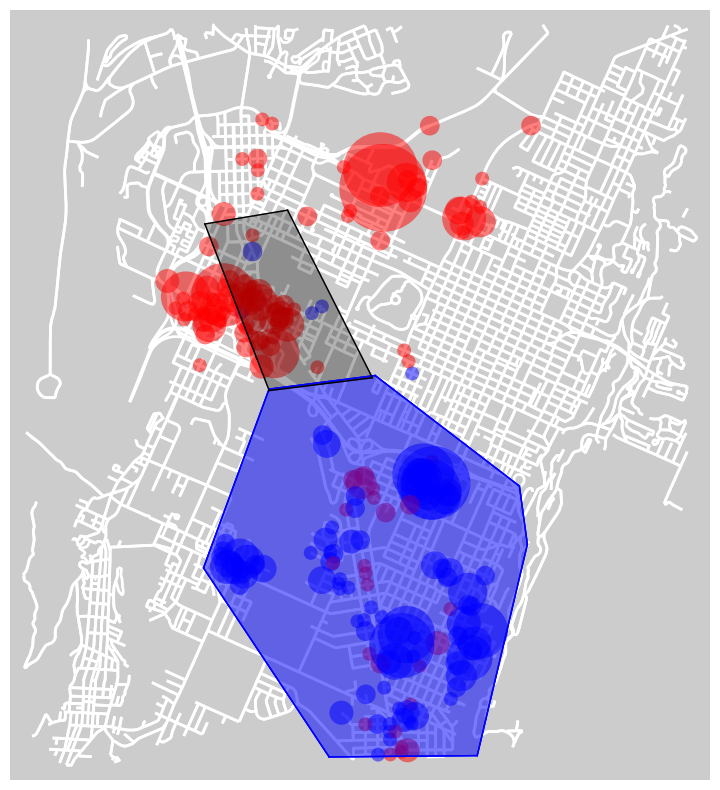

In [11]:
from multimodal_class import *
WORLD1.plotPRELIMINARIES(include_demand_curves=False,save_file=save_outputs_folder+'/figs/od_regions.png',figsize=(5,5));

### FIT CONGESTION DEMAND MODELS

In [12]:
from multimodal_class import *
WORLD1.load_fits = False;
# counts = {'num_counts':8,'num_per_count':1}
counts = {'num_counts':4,'num_per_count':1}
WORLD1.fitModels(counts=counts,force_initialize=True);

load fits not specified...
generating fits...
updating individual choices...
person1734 ...
person8347 ...
person658 ...
DEMAND CURVE - generate (takes 10 MIN...)
...runs VRP solver (num_pts*num_per_count) times...
### ~ approx. 1 run/15 seconds...
starting on-demand curve computations for a total of 211 trips...
starting on-demand curve computation for group NUMBER  0
...for a total number of trips of 141
counts to compute:  [14, 51, 88, 126]
...computing averages for 14 active ondemand trips in group0 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:19:59,683: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:20:00,078: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:20:00,484: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:20:00,486: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:20:00,487: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:20:00,487: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:20:00,488: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:20:00,488: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:20:00,490: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  2048.4
...computing averages for 51 active ondemand trips in group0 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:20:29,200: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:20:30,438: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:20:31,616: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:20:31,617: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:20:31,617: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:20:31,618: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:20:31,618: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:20:31,619: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:20:31,620: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  1962.5192307692307
...computing averages for 88 active ondemand trips in group0 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:21:39,188: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:21:41,333: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:21:43,594: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:21:43,595: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:21:43,596: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:21:43,597: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:21:43,597: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:21:43,597: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:21:43,599: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  2052.1573033707864
...computing averages for 126 active ondemand trips in group0 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:23:29,610: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:23:33,099: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:23:36,873: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:23:36,873: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:23:36,874: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:23:36,874: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:23:36,875: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:23:36,875: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:23:36,876: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  2188.5702479338843
starting on-demand curve computation for group NUMBER  1
...for a total number of trips of 70
counts to compute:  [7, 25, 43, 62]
...computing averages for 7 active ondemand trips in group1 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:26:14,618: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:26:14,898: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:26:15,178: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:26:15,179: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:26:15,180: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:26:15,180: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:26:15,181: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:26:15,181: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:26:15,182: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  1680.875
...computing averages for 25 active ondemand trips in group1 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:26:47,273: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:26:47,809: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:26:48,367: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:26:48,368: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:26:48,368: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:26:48,369: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:26:48,369: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:26:48,370: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:26:48,370: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  2218.6923076923076
...computing averages for 43 active ondemand trips in group1 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:28:01,485: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:28:02,402: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:28:03,343: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:28:03,343: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:28:03,344: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:28:03,344: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:28:03,345: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:28:03,345: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:28:03,347: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  2651.5454545454545
...computing averages for 62 active ondemand trips in group1 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:30:04,493: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:30:05,916: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:30:07,266: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:30:07,267: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:30:07,267: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:30:07,267: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:30:07,268: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:30:07,268: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:30:07,270: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  2445.15873015873


### PRELIMINARY DEMAND CURVES (OPTIONAL)

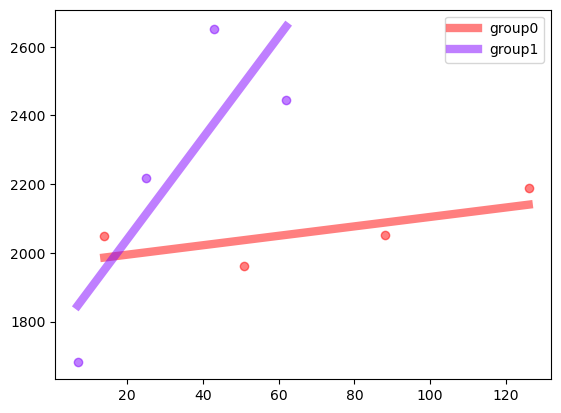

In [13]:
colors = {'group0':[1,0,0,0.5],'group1':[0.5,0,1,0.5],'group2':[0,0,1,0.5],'group3':[1,0.5,0.,0.5]};
WORLD1.ONDEMAND.plotCongestionModels(colors=colors,save_file=save_outputs_folder+'/figs/demand_curves.pdf')

### SAVE CONGESTION DEMAND MODELS (OPTIONAL)

In [14]:
# WORLD1.save_fits = True; #se; # must be set to True
# WORLD1.save_fits_file = save_fits_file; 
# WORLD1.saveFits();

In [15]:
vars(WORLD1.ONDEMAND.groups['group0'])

{'GRAPHS': {'drive': <networkx.classes.multidigraph.MultiDiGraph at 0x295ebd5d0>,
  'walk': <networkx.classes.multidigraph.MultiDiGraph at 0x2915ff9d0>,
  'gtfs': <networkx.classes.multidigraph.MultiDiGraph at 0x290c70710>,
  'ondemand': <networkx.classes.multidigraph.MultiDiGraph at 0x290c71850>,
  'all': <networkx.classes.multidigraph.MultiDiGraph at 0x290c72f50>},
 'FEEDS': {'gtfs': <gtfs_functions.gtfs_functions.Feed at 0x284cc9dd0>},
 'MARG': {(202659746.0, 202739258.0): 0,
  (202684141.0, 202605289.0): 0,
  (202645935.0, 202605276.0): 0,
  (202663276.0, 202605276.0): 0,
  (202687360.0, 202639162.0): 0,
  (202645895.0, 202605283.0): 0,
  (202612606.0, 202605283.0): 0,
  (1846176325.0, 202739042.0): 0,
  (202647789.0, 202639162.0): 0,
  (202671025.0, 202605252.0): 0,
  (202612604.0, 202605283.0): 0,
  (202765230.0, 202605308.0): 0,
  (202612609.0, 202731397.0): 0,
  (202744216.0, 202731397.0): 0,
  (202612609.0, 202605289.0): 0,
  (202734578.0, 202739042.0): 0,
  (1309428436.0, 202

# RUN SIMULATION

In [16]:
from multimodal_class import *
num_iters = 10;
WORLD1.SIM(num_iters = num_iters, restart = False, constants = ['drive','gtfs','walk']);
WORLD1.initUNCONGESTED()

------------------ITERATION 1 -----------
starting gtfs computations...
...with  222  active trips...
REMOVING MASS FROM GTFS TRIPS...
starting driving computations...
...with  0  active trips...
starting walking computations...
...with  253  active trips...
...segment 0 ...
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 141 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:34:39,231: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:34:43,454: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:34:47,906: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:34:47,906: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:34:47,907: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:34:47,907: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:34:47,908: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:34:47,909: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:34:47,910: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: -1430.8819349415749
...actual num trips: 141
...adjusting cost estimate by 785.9409674707874
...average manifest trip time:  2458.3809523809523
...changing cost est from 0.0 to 1967.0266970641312
COMPUTING ondemand trips for  group1
...with 70 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:38:29,939: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:38:31,543: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:38:33,158: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:38:33,159: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:38:33,159: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:38:33,160: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:38:33,160: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:38:33,161: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:38:33,162: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: -118.07583559100249
...actual num trips: 70
...adjusting cost estimate by 94.03791779550124
...average manifest trip time:  2846.042253521127
...changing cost est from 0.0 to 1743.371814680817
updating individual choices...
person1734 ...
person658 ...
iteration time:  548.6989271640778
------------------ITERATION 2 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 42 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:41:54,453: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:41:55,392: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:41:56,445: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:41:56,446: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:41:56,447: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:41:56,447: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:41:56,448: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:41:56,449: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:41:56,453: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 0.0
...actual num trips: 42
...adjusting cost estimate by 14.0
...average manifest trip time:  1871.9302325581396
...changing cost est from 1967.0266970641312 to 1981.0266970641312
COMPUTING ondemand trips for  group1
...with 51 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:42:55,002: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:42:56,111: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:42:57,285: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:42:57,286: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:42:57,286: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:42:57,287: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:42:57,287: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:42:57,288: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:42:57,289: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 0.0
...actual num trips: 51
...adjusting cost estimate by 17.0
...average manifest trip time:  2610.019230769231
...changing cost est from 1743.371814680817 to 1760.371814680817
updating individual choices...
person1734 ...
person658 ...
iteration time:  210.79906606674194
------------------ITERATION 3 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 28 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:45:24,425: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:45:25,184: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:45:25,858: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:45:25,859: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:45:25,860: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:45:25,861: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:45:25,862: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:45:25,863: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:45:25,864: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 10.184074836951199
...actual num trips: 28
...adjusting cost estimate by 4.453981290762201
...average manifest trip time:  1469.1379310344828
...changing cost est from 1981.0266970641312 to 1985.4806783548934
COMPUTING ondemand trips for  group1
...with 46 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:46:08,417: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:46:09,453: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:46:10,517: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:46:10,517: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:46:10,518: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:46:10,518: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:46:10,519: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:46:10,519: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:46:10,520: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 1.1513833068446986
...actual num trips: 46
...adjusting cost estimate by 11.212154173288825
...average manifest trip time:  2712.723404255319
...changing cost est from 1760.371814680817 to 1771.5839688541057
updating individual choices...
person1734 ...
person658 ...
iteration time:  177.5310389995575
------------------ITERATION 4 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 26 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:48:21,924: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:48:22,524: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:48:23,141: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:48:23,143: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:48:23,143: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:48:23,144: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:48:23,145: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:48:23,146: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:48:23,148: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 13.424051893201366
...actual num trips: 26
...adjusting cost estimate by 2.515189621359727
...average manifest trip time:  1783.888888888889
...changing cost est from 1985.4806783548934 to 1987.995867976253
COMPUTING ondemand trips for  group1
...with 33 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:49:07,078: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:49:07,801: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:49:08,488: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:49:08,489: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:49:08,489: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:49:08,490: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:49:08,490: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:49:08,491: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:49:08,492: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 1.910764903838455
...actual num trips: 33
...adjusting cost estimate by 6.217847019232309
...average manifest trip time:  2613.794117647059
...changing cost est from 1771.5839688541057 to 1777.801815873338
updating individual choices...
person1734 ...
person658 ...
iteration time:  153.2313208580017
------------------ITERATION 5 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 24 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:50:54,933: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:50:55,655: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:50:56,187: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:50:56,187: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:50:56,188: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:50:56,188: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:50:56,189: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:50:56,189: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:50:56,191: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 15.253686131276371
...actual num trips: 24
...adjusting cost estimate by 1.4577189781206048
...average manifest trip time:  1468.48
...changing cost est from 1987.995867976253 to 1989.4535869543736
COMPUTING ondemand trips for  group1
...with 29 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:51:35,772: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:51:36,456: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:51:37,154: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:51:37,155: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:51:37,155: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:51:37,156: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:51:37,157: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:51:37,157: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:51:37,158: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 2.3318899192771685
...actual num trips: 29
...adjusting cost estimate by 4.444685013453805
...average manifest trip time:  2519.9
...changing cost est from 1777.801815873338 to 1782.2465008867919
updating individual choices...
person1734 ...
person658 ...
iteration time:  138.24703788757324
------------------ITERATION 6 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 23 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:53:13,259: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:53:13,856: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:53:14,405: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:53:14,406: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:53:14,406: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:53:14,407: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:53:14,407: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:53:14,408: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:53:14,409: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 16.314080357306608
...actual num trips: 23
...adjusting cost estimate by 0.9551313775276273
...average manifest trip time:  1546.4583333333333
...changing cost est from 1989.4535869543736 to 1990.4087183319011
COMPUTING ondemand trips for  group1
...with 27 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:53:55,780: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:53:56,541: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:53:57,211: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:53:57,212: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:53:57,212: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:53:57,213: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:53:57,213: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:53:57,213: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:53:57,214: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 2.632921456257968
...actual num trips: 27
...adjusting cost estimate by 3.481011220534576
...average manifest trip time:  2245.75
...changing cost est from 1782.2465008867919 to 1785.7275121073264
updating individual choices...
person1734 ...
person658 ...
iteration time:  130.6434361934662
------------------ITERATION 7 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 22 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:55:23,724: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:55:24,373: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:55:25,068: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:55:25,069: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:55:25,070: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:55:25,070: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:55:25,070: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:55:25,071: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:55:25,072: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 17.008875316439525
...actual num trips: 22
...adjusting cost estimate by 0.6238905854450594
...average manifest trip time:  1351.2608695652175
...changing cost est from 1990.4087183319011 to 1991.0326089173461
COMPUTING ondemand trips for  group1
...with 26 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:56:03,951: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:56:04,609: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:56:05,257: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:56:05,258: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:56:05,259: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:56:05,259: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:56:05,260: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:56:05,260: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:56:05,262: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 2.8686848803910623
...actual num trips: 26
...adjusting cost estimate by 2.8914143899511173
...average manifest trip time:  2230.962962962963
...changing cost est from 1785.7275121073264 to 1788.6189264972775
updating individual choices...
person1734 ...
person658 ...
iteration time:  123.25013709068298
------------------ITERATION 8 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 22 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:57:27,013: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:57:27,626: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:57:28,207: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:57:28,208: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:57:28,208: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:57:28,208: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:57:28,209: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:57:28,209: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:57:28,210: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 17.462714488742463
...actual num trips: 22
...adjusting cost estimate by 0.5041428345841708
...average manifest trip time:  1150.4782608695652
...changing cost est from 1991.0326089173461 to 1991.5367517519303
COMPUTING ondemand trips for  group1
...with 25 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:58:02,967: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:58:03,605: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:58:04,313: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:58:04,314: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:58:04,314: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:58:04,315: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:58:04,315: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:58:04,316: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:58:04,317: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 3.0645158369651893
...actual num trips: 25
...adjusting cost estimate by 2.437276018114979
...average manifest trip time:  2033.8461538461538
...changing cost est from 1788.6189264972775 to 1791.0562025153924
updating individual choices...
person1734 ...
person658 ...
iteration time:  115.08017992973328
------------------ITERATION 9 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 22 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:59:22,072: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:59:22,595: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:59:23,175: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:59:23,176: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:59:23,176: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:59:23,177: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:59:23,177: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:59:23,178: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:59:23,179: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 17.829445085593743
...actual num trips: 22
...adjusting cost estimate by 0.4170554914406257
...average manifest trip time:  1150.4782608695652
...changing cost est from 1991.5367517519303 to 1991.9538072433709
COMPUTING ondemand trips for  group1
...with 24 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 04:59:57,610: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 04:59:58,199: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 04:59:58,718: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 04:59:58,718: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 04:59:58,719: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 04:59:58,719: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 04:59:58,720: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 04:59:58,720: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 04:59:58,721: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 3.2295887146963946
...actual num trips: 24
...adjusting cost estimate by 2.0770411285303605
...average manifest trip time:  2102.16
...changing cost est from 1791.0562025153924 to 1793.1332436439227
updating individual choices...
person1734 ...
person658 ...
iteration time:  113.99503374099731
------------------ITERATION 10 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 22 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 05:01:16,058: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 05:01:16,557: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 05:01:17,177: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 05:01:17,178: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 05:01:17,178: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 05:01:17,179: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 05:01:17,179: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 05:01:17,180: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 05:01:17,181: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 18.13282539530748
...actual num trips: 22
...adjusting cost estimate by 0.35156132769931986
...average manifest trip time:  1150.4782608695652
...changing cost est from 1991.9538072433709 to 1992.3053685710702
COMPUTING ondemand trips for  group1
...with 24 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-03-22 05:01:51,676: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-03-22 05:01:52,207: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-03-22 05:01:52,748: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-03-22 05:01:52,749: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-03-22 05:01:52,749: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-03-22 05:01:52,749: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-03-22 05:01:52,750: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-03-22 05:01:52,750: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-03-22 05:01:52,751: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 3.370263448991666
...actual num trips: 24
...adjusting cost estimate by 1.8754305955462123
...average manifest trip time:  2102.16
...changing cost est from 1793.1332436439227 to 1795.008674239469
updating individual choices...
person1734 ...
person658 ...
iteration time:  114.51233792304993


In [17]:
WORLD1.initUNCONGESTED()

computing uncongested trip costs for mode drive ...
computing uncongested trip costs for mode walk ...
...segment number 0
...segment number 50
...segment number 100
...segment number 150
...segment number 200
...segment number 250
computing uncongested trip costs for mode gtfs ...
...segment number 0
...segment number 50
...segment number 100
...segment number 150
...segment number 200
computing uncongested trip costs for mode ondemand ...
...segment number 0
...segment number 50
...segment number 100
...segment number 150
...segment number 200


### PLOT DEMAND CONVERGENCE 

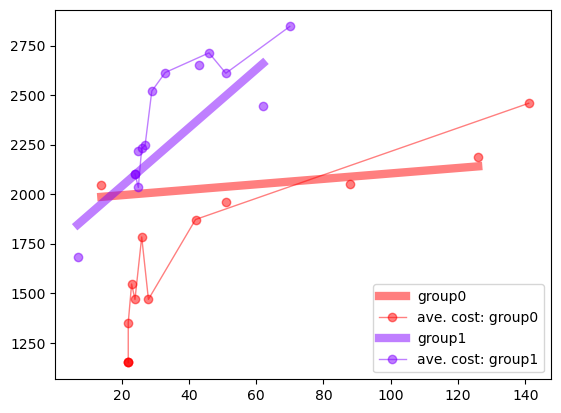

In [18]:
colors = {'group0':[1,0,0,0.5],'group1':[0.5,0,1,0.5],'group2':[0,0,1,0.5],'group3':[1,0.5,0.,0.5]};
WORLD1.ONDEMAND.plotCongestionModels(colors=colors,with_converge = True, save_file=save_outputs_folder+'/figs/demand_curves_wconvergence.pdf')

# SETUP SIMULATION

### GENERATE OUTPUTS

In [19]:
from multimodal_class import *
WORLD1.generateOutputs(); #randomize=['money','switches']);

### PRINT OUTPUTS

In [20]:
mode = 'ondemand'
dfs_to_show = [mode]
WORLD1.printOutputs(show_active=True,dfs_to_show = dfs_to_show,row_count = 100); 

drive statistics ... printing dataframe of length 0
walk statistics ... printing dataframe of length 210
gtfs statistics ... printing dataframe of length 66
ondemand statistics ... printing dataframe of length 46
              seg_id      mode  \
0      ondemand_seg0  ondemand   
3      ondemand_seg3  ondemand   
5      ondemand_seg5  ondemand   
8      ondemand_seg8  ondemand   
16    ondemand_seg16  ondemand   
26    ondemand_seg26  ondemand   
27    ondemand_seg27  ondemand   
30    ondemand_seg30  ondemand   
32    ondemand_seg32  ondemand   
37    ondemand_seg37  ondemand   
39    ondemand_seg39  ondemand   
40    ondemand_seg40  ondemand   
41    ondemand_seg41  ondemand   
46    ondemand_seg46  ondemand   
48    ondemand_seg48  ondemand   
51    ondemand_seg51  ondemand   
58    ondemand_seg58  ondemand   
60    ondemand_seg60  ondemand   
69    ondemand_seg69  ondemand   
70    ondemand_seg70  ondemand   
75    ondemand_seg75  ondemand   
81    ondemand_seg81  ondemand   
83   

### SAVE OUTPUTS

In [21]:
WORLD1.saveOutputs(save_outputs_folder,typ='pickle',overwrite=True)

overwriting...


### GENERATE DASHBOARD

In [22]:
from multimodal_class import *
WORLD1.generateLayers();
WORLD1.plotLAYERS(folder = dashboard_folder,overwrite = True,verbose=False)

starting to create plotting layers...
time to create layers: 6.919124364852905
starting layers...
PLOTTING LAYER 0 ...
PLOTTING LAYER 20 ...
PLOTTING LAYER 40 ...
PLOTTING LAYER 60 ...
PLOTTING LAYER 80 ...
PLOTTING LAYER 100 ...
PLOTTING LAYER 120 ...
PLOTTING LAYER 140 ...
PLOTTING LAYER 160 ...
PLOTTING LAYER 180 ...
PLOTTING LAYER 200 ...
PLOTTING LAYER 220 ...
PLOTTING LAYER 240 ...
PLOTTING LAYER 260 ...
PLOTTING LAYER 280 ...
PLOTTING LAYER 300 ...
finished.


### SHOW DASHBOARD

In [23]:
from multimodal_class import *
WORLD1.DASH = DASHBOARD(WORLD1.dash_folder);
WORLD1.DASH.makeGrid();
WORLD1.DASH.addOutputs(WORLD1.OUTPUTS,use_active=True,filter_for_zeros=True)
WORLD1.DASH.addImages(WORLD1.layers)

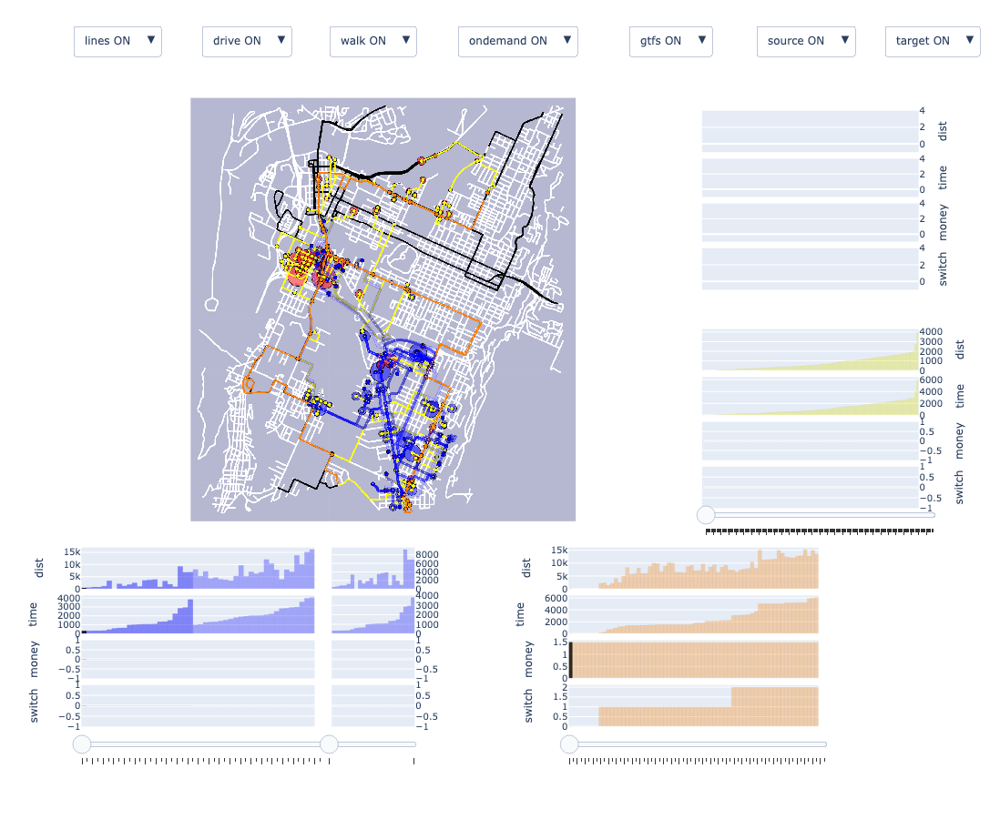

In [24]:
WORLD1.DASH.show()

### CREATE HTML DASHBOARD

In [25]:
import plotly.io as pio
pio.write_html(WORLD1.DASH.fig, file=dashboard_folder+'/dash.html', auto_open=True)

####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT 
####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT 
####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT 
####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT 

In [ ]:
group = 'group0'
GROUP = WORLD1.ONDEMAND.groups[group];
# GROUP.actual_num_segs = [];
# GROUP.expected_cost = [];
# GROUP.actual_average_cost = [];
plt.plot(GROUP.expected_cost)
plt.plot(GROUP.actual_average_cost)

# actual_num_segs.append(num_segs)
# GROUP.expected_cost.append(new_ave_cost)
# GROUP.current_expected_cost = new_ave_cost
# GROUP.actual_average_cost.append(average_time)


In [ ]:
# group='group1'
# GROUP = WORLD1.ONDEMAND.groups[group];
# GROUP.actual_num_segs = GROUP.actual_num_segs[6:]
